<a href="https://colab.research.google.com/github/mrunaliyadav003/AI-ML/blob/main/Antidrone.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Mount Google Drive to access files
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
!pip install pydub


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
!pip install scipy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [5]:
from scipy.io import wavfile
import io

In [6]:
!pip install tensorflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [7]:
!pip install -U -q tensorflow tensorflow_datasets
!apt install --allow-change-held-packages libcudnn8=8.1.0.77-1+cuda11.2

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following packages will be REMOVED:
  libcudnn8-dev
The following held packages will be changed:
  libcudnn8
The following packages will be DOWNGRADED:
  libcudnn8
0 upgraded, 0 newly installed, 1 downgraded, 1 to remove and 11 not upgraded.
Need to get 430 MB of archives.
After this operation, 1,027 MB disk space will be freed.
Get:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  libcudnn8 8.1.0.77-1+cuda11.2 [430 MB]
Fetched 430 MB in 8s (56.7 MB/s)
(Reading database ... 123069 files and directories currently installed.)
Removing libcudnn8-dev (8.9.0.131-1+cuda11.8) ...
update-alternatives: removing manually selected alternative - switching libcudnn to auto mode
dpkg: warning: downgrading libcudnn8 from 8.9.0.131-1+cuda11.8 to 8.1.0.77-1+cuda11.2
(Reading database ... 123036 files and directories currently installed.)
Preparing to unpack .../libcudnn8_8.1.0

In [8]:
import os
import pathlib

import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import tensorflow as tf

from tensorflow.keras import layers
from tensorflow.keras import models
from IPython import display

# Set the seed value for experiment reproducibility.
seed = 42
tf.random.set_seed(seed)
np.random.seed(seed)

In [9]:
from sklearn.model_selection import train_test_split

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Input, Conv2D, MaxPool2D, Dropout, Dense, BatchNormalization
from tensorflow.keras.layers import Flatten
from tensorflow.keras.models import Sequential
import random
from tensorflow.keras.models import Model
from keras.utils.np_utils import to_categorical

In [10]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2 as cv
import json
from sklearn.model_selection import train_test_split
import pandas as pd
from datetime import datetime
from termcolor import colored
import os,glob


import PIL
import tensorflow as tf
import matplotlib.pyplot as plt

from pydub import AudioSegment
import soundfile as sf
import librosa

from matplotlib.pyplot import figure, imshow, axis

import warnings
warnings.filterwarnings('ignore')

In [11]:
from numpy.random import seed
seed(1)

import tensorflow
tensorflow.random.set_seed(2)

In [12]:
dir_path = '/content/drive/MyDrive/paras/Audio'
digits = sorted(os.listdir(dir_path))
NUM_CLASSES = len(digits)
print(digits)
print('Number of classes : ', NUM_CLASSES)

['BACKGROUND_001.wav', 'BACKGROUND_002.wav', 'BACKGROUND_003.wav', 'BACKGROUND_004.wav', 'BACKGROUND_005.wav', 'BACKGROUND_006.wav', 'BACKGROUND_007.wav', 'BACKGROUND_008.wav', 'BACKGROUND_009.wav', 'BACKGROUND_010.wav', 'BACKGROUND_011.wav', 'BACKGROUND_012.wav', 'BACKGROUND_013.wav', 'BACKGROUND_014.wav', 'BACKGROUND_015.wav', 'BACKGROUND_016.wav', 'BACKGROUND_017.wav', 'BACKGROUND_018.wav', 'BACKGROUND_019.wav', 'BACKGROUND_020.wav', 'BACKGROUND_021.wav', 'BACKGROUND_022.wav', 'BACKGROUND_023.wav', 'BACKGROUND_024.wav', 'BACKGROUND_025.wav', 'BACKGROUND_026.wav', 'BACKGROUND_027.wav', 'BACKGROUND_028.wav', 'BACKGROUND_029.wav', 'BACKGROUND_030.wav', 'DRONE_001.wav', 'DRONE_002.wav', 'DRONE_003.wav', 'DRONE_004.wav', 'DRONE_005.wav', 'DRONE_006.wav', 'DRONE_007.wav', 'DRONE_008.wav', 'DRONE_009.wav', 'DRONE_010.wav', 'DRONE_011.wav', 'DRONE_012.wav', 'DRONE_013.wav', 'DRONE_014.wav', 'DRONE_015.wav', 'DRONE_016.wav', 'DRONE_017.wav', 'DRONE_018.wav', 'DRONE_019.wav', 'DRONE_020.wav',

In [13]:
Audio='/content/drive/MyDrive/paras/Audio'


In [15]:
#create an empty DataFrame for audio
df = pd.DataFrame(columns=['path','label'])

#loop over bird images and label them 1
for dirname, _, filenames in os.walk(Audio):
    for filename in filenames:
        #print(os.path.join(dirname, filename))
        df = df.append(pd.DataFrame([[os.path.join(dirname, filename),'Audio']],columns=['path','label']))

df = df.sample(frac=1).reset_index(drop=True)
df.head(100)

,path,label
0,/content/drive/MyDrive/paras/Audio/BACKGROUND_...,Audio
1,/content/drive/MyDrive/paras/Audio/BACKGROUND_...,Audio
2,/content/drive/MyDrive/paras/Audio/DRONE_016.wav,Audio
3,/content/drive/MyDrive/paras/Audio/DRONE_007.wav,Audio
4,/content/drive/MyDrive/paras/Audio/HELICOPTER_...,Audio
...,...,...
85,/content/drive/MyDrive/paras/Audio/DRONE_024.wav,Audio
86,/content/drive/MyDrive/paras/Audio/DRONE_009.wav,Audio
87,/content/drive/MyDrive/paras/Audio/DRONE_011.wav,Audio
88,/content/drive/MyDrive/paras/Audio/HELICOPTER_...,Audio


In [ ]:
#create an empty DataFrame for audio
df = pd.DataFrame(columns=['path','label'])

#loop over bird images and label them 1
for dirname, _, filenames in os.walk(Unseen_Drone_Audio):
    for filename in filenames:
        #print(os.path.join(dirname, filename))
        df = df.append(pd.DataFrame([[os.path.join(dirname, filename),'Unseen_Drone_Audio']],columns=['path','label']))

#loop over Drone images and label them 0
for dirname, _, filenames in os.walk(drone):
    for filename in filenames:
        df = df.append(pd.DataFrame([[os.path.join(dirname, filename),'drone']],columns=['path','label']))
        #print(os.path.join(dirname, filename))

#loop over Drone images and label them 0
for dirname, _, filenames in os.walk(no_drone):
    for filename in filenames:
        df = df.append(pd.DataFrame([[os.path.join(dirname, filename),'no_drone']],columns=['path','label']))
        #print(os.path.join(dirname, filename))


#shuffle the dataset for redistribute the labels
df = df.sample(frac=1).reset_index(drop=True)
df.head(100)

,path,label
0,/content/drive/MyDrive/Acoustic-UAV-Identifica...,no_drone
1,/content/drive/MyDrive/Acoustic-UAV-Identifica...,no_drone
2,/content/drive/MyDrive/Acoustic-UAV-Identifica...,no_drone
3,/content/drive/MyDrive/Acoustic-UAV-Identifica...,drone
4,/content/drive/MyDrive/Acoustic-UAV-Identifica...,no_drone
...,...,...
95,/content/drive/MyDrive/Acoustic-UAV-Identifica...,no_drone
96,/content/drive/MyDrive/Acoustic-UAV-Identifica...,drone
97,/content/drive/MyDrive/Acoustic-UAV-Identifica...,no_drone
98,/content/drive/MyDrive/Acoustic-UAV-Identifica...,drone


In [ ]:
DATASET_PATH = '/content/drive/MyDrive/Acoustic-UAV-Identification-main/Real World Testing'

data_dir = pathlib.Path(DATASET_PATH)
if not data_dir.exists():
  tf.keras.utils.get_file(
      'Drone-detection-dataset',
      origin="/content/drive/MyDrive/Acoustic-UAV-Identification-main/Real World Testing",
      extract=True,
      cache_dir='.', cache_subdir='data')

In [ ]:
df.shape

(548, 2)

<Axes: >

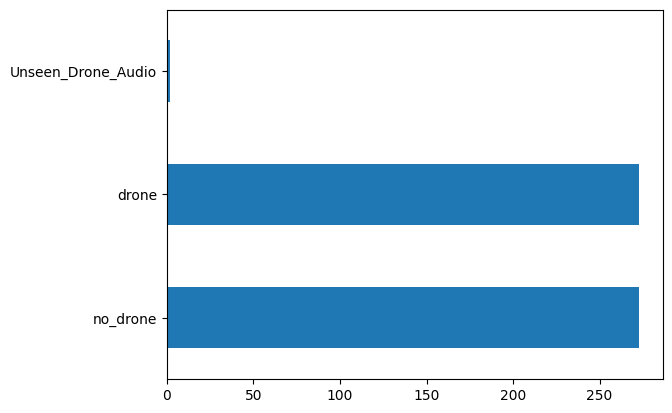

In [ ]:
df['label'].value_counts().plot.barh()

In [ ]:
import numpy as np
commands = np.array(tf.io.gfile.listdir(str(data_dir)))
commands = commands[(commands != '/content/drive/MyDrive/Acoustic-UAV-Identification-main/Real World Testing') & (commands != '/content/drive/MyDrive/Acoustic-UAV-Identification-main')]
print('Commands:', commands)

Commands: ['Unseen Drone Audio' 'no drone' 'drone']


In [ ]:
train_ds, val_ds = tf.keras.utils.audio_dataset_from_directory(
    directory=data_dir,
    batch_size=64,
    validation_split=0.2,
    seed=0,
    output_sequence_length=2646000 ,
    subset='both')

label_names = np.array(train_ds.class_names)
print()
print("label names:", label_names)

Found 548 files belonging to 3 classes.
Using 439 files for training.
Using 109 files for validation.

label names: ['Unseen Drone Audio' 'drone' 'no drone']


In [ ]:
train_ds.element_spec

(TensorSpec(shape=(None, 2646000, None), dtype=tf.float32, name=None),
 TensorSpec(shape=(None,), dtype=tf.int32, name=None))

In [ ]:
def squeeze(audio, labels):
  audio = tf.squeeze(audio, axis=-1)
  return audio, labels

train_ds = train_ds.map(squeeze, tf.data.AUTOTUNE)
val_ds = val_ds.map(squeeze, tf.data.AUTOTUNE)

In [ ]:
test_ds = val_ds.shard(num_shards=2, index=0)
val_ds = val_ds.shard(num_shards=2, index=1)

In [ ]:
train_ds.take(1)

<_TakeDataset element_spec=(TensorSpec(shape=(None, 2646000), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [ ]:
for example_audio, example_labels in train_ds.take(1):
  print(example_audio.shape)
  print(example_labels.shape)

(64, 2646000)
(64,)


In [ ]:
label_names[[1,0,2]]

array(['drone', 'Unseen Drone Audio', 'no drone'], dtype='<U18')

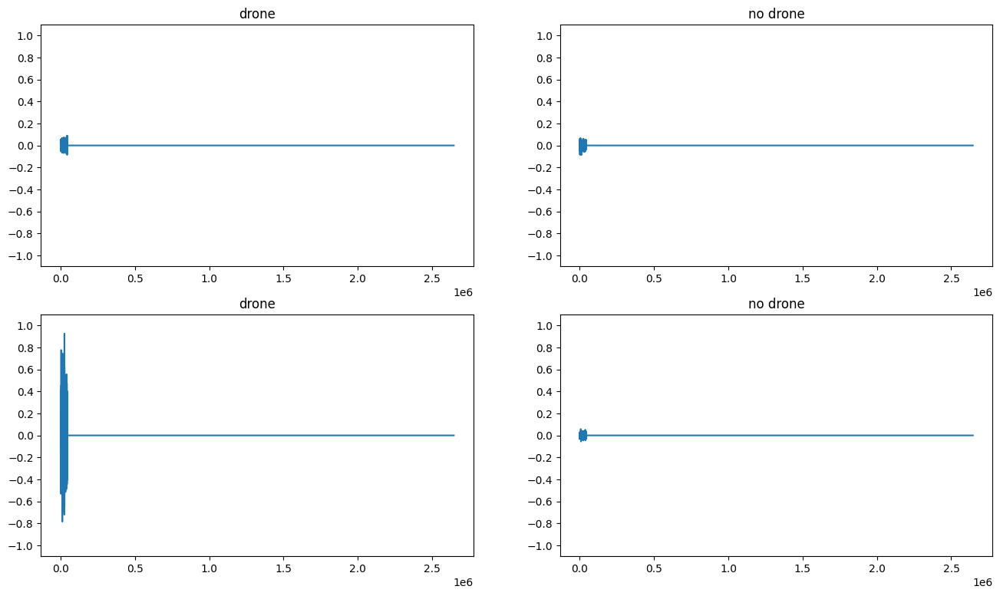

In [ ]:
rows = 2
cols = 2
n = rows * cols
fig, axes = plt.subplots(rows, cols, figsize=(16, 9))

for i in range(n):
  if i>=n:
    break
  r = i // cols
  c = i % cols
  ax = axes[r][c]    #plot fft  amplitude vs time
  ax.plot(example_audio[i].numpy())
  ax.set_yticks(np.arange(-1.2, 1.2, 0.2))
  label = label_names[example_labels[i]]
  ax.set_title(label)
  ax.set_ylim([-1.1,1.1])

plt.show()

In [ ]:
def get_spectrogram(waveform):
  # Convert the waveform to a spectrogram via a STFT.
  spectrogram = tf.signal.stft(
      waveform, frame_length=255, frame_step=128)
  # Obtain the magnitude of the STFT.
  spectrogram = tf.abs(spectrogram)
  # Add a `channels` dimension, so that the spectrogram can be used
  # as image-like input data with convolution layers (which expect
  # shape (`batch_size`, `height`, `width`, `channels`).
  spectrogram = spectrogram[..., tf.newaxis]
  return spectrogram

In [ ]:
for i in range(4):
  label = label_names[example_labels[i]]
  waveform = example_audio[i]
  spectrogram = get_spectrogram(waveform)

  print('Label:', label)
  print('Waveform shape:', waveform.shape)
  print('Spectrogram shape:', spectrogram.shape)
  print('Audio playback')
  display.display(display.Audio(waveform, rate=16000))

Label: drone
Waveform shape: (2646000,)
Spectrogram shape: (20670, 129, 1)
Audio playback


Label: no drone
Waveform shape: (2646000,)
Spectrogram shape: (20670, 129, 1)
Audio playback


Label: drone
Waveform shape: (2646000,)
Spectrogram shape: (20670, 129, 1)
Audio playback


Label: no drone
Waveform shape: (2646000,)
Spectrogram shape: (20670, 129, 1)
Audio playback


In [ ]:
def plot_spectrogram(spectrogram, ax):
  if len(spectrogram.shape) > 2:
    assert len(spectrogram.shape) == 3
    spectrogram = np.squeeze(spectrogram, axis=-1)
  # Convert the frequencies to log scale and transpose, so that the time is
  # represented on the x-axis (columns).
  # Add an epsilon to avoid taking a log of zero.
  log_spec = np.log(spectrogram.T + np.finfo(float).eps)
  height = log_spec.shape[0]
  width = log_spec.shape[1]
  X = np.linspace(0, np.size(spectrogram), num=width, dtype=int)
  Y = range(height)
  ax.pcolormesh(X, Y, log_spec)

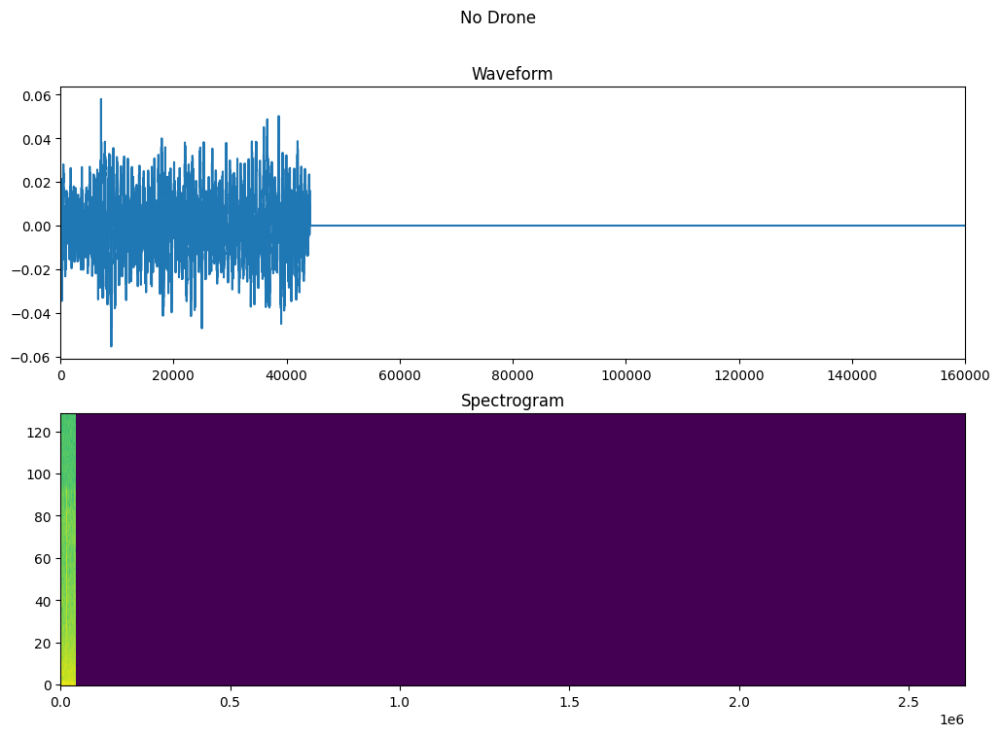

In [ ]:
fig, axes = plt.subplots(2, figsize=(12, 8))
timescale = np.arange(waveform.shape[0])
axes[0].plot(timescale, waveform.numpy())
axes[0].set_title('Waveform')
axes[0].set_xlim([0, 160000])

plot_spectrogram(spectrogram.numpy(), axes[1])
axes[1].set_title('Spectrogram')
plt.suptitle(label.title())
plt.show()

In [ ]:
def make_spec_ds(ds):
  return ds.map(
      map_func=lambda audio,label: (get_spectrogram(audio), label),
      num_parallel_calls=tf.data.AUTOTUNE)

In [ ]:
def train_spectrogram_ds(example_spectrograms, example_spect_labels):
  train_spectrogram_ds = make_spec_ds(train_ds)
  val_spectrogram_ds = make_spec_ds(val_ds)
  test_spectrogram_ds = make_spec_ds(test_ds)

In [ ]:
def train_spectrogram_ds(example_spectrograms, example_spect_labels):
    def train_data(train_spectrogram_ds):
        for example_spectrograms, example_spect_labels in  train_spectrogram_ds.take(1):
            break

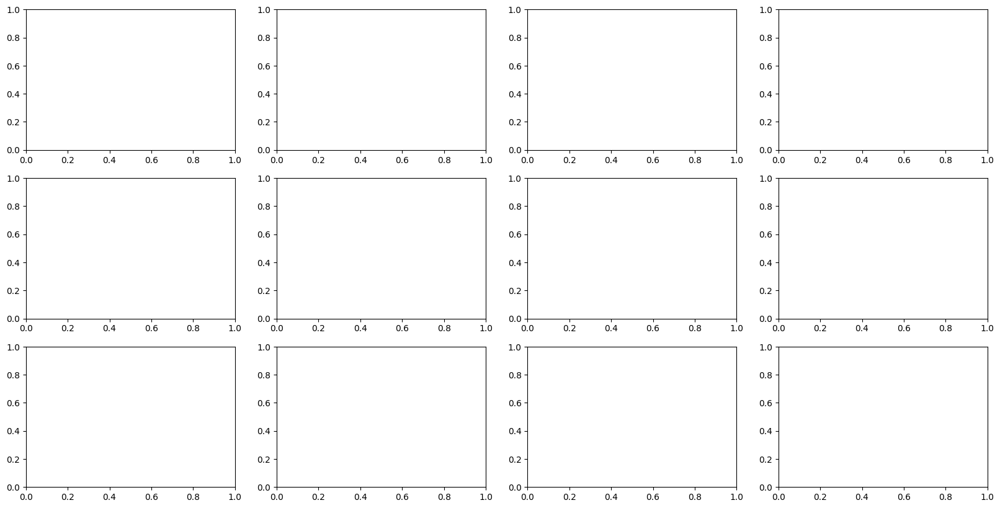

In [ ]:
import matplotlib.pyplot as plt

rows = 3
cols = 4

fig, axes = plt.subplots(rows, cols, figsize=(20, 10))

for i in range(rows * cols):
    if i < len(example_spectrograms):
        r = i // cols
        c = i % cols
        ax = axes[r][c]
        plot_spectrogram(example_spectrograms[i].numpy(), ax)
        ax.set_title(label_names[example_spect_labels[i].numpy()])

In [ ]:
import matplotlib.pyplot as plt

def plot_spectrogram(spec, ax):
    im = ax.imshow(spec, origin='lower', cmap='inferno')
    ax.set_xlabel('Time')
    ax.set_ylabel('Frequency')
    plt.colorbar(im, ax=ax)

In [ ]:
def train_spectrogram_ds(spectrogram_ds):
  train_spectrogram_ds = spectrogram_ds.take(1000) # First 1000 spectrograms for training
  val_spectrogram_ds = spectrogram_ds.skip(1000) # Remaining spectrograms for validation
  test_spectrogram_ds = spectrogram_ds.skip(1000)

In [ ]:
import tensorflow as tf

def train_spectrogram_ds(train_spectrograms, train_labels, val_spectrograms, val_labels, test_spectrograms, test_labels):
# Example code to create a tf.data.Dataset object
  train_spectrogram_ds = tf.data.Dataset.from_tensor_slices((train_spectrograms, train_labels))
  val_spectrogram_ds = tf.data.Dataset.from_tensor_slices((val_spectrograms, val_labels))
  test_spectrogram_ds = tf.data.Dataset.from_tensor_slices((test_spectrograms, test_labels))

  train_spectrogram_ds = train_spectrogram_ds.cache().shuffle(10000).prefetch(tf.data.AUTOTUNE)
  val_spectrogram_ds = val_spectrogram_ds.cache().prefetch(tf.data.AUTOTUNE)
  test_spectrogram_ds = test_spectrogram_ds.cache().prefetch(tf.data.AUTOTUNE)


In [ ]:
batch_size = 64
train_ds = train_ds.batch(batch_size)
val_ds = val_ds.batch(batch_size)

In [ ]:
from sklearn.model_selection import train_test_split

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Input, Conv2D, MaxPool2D, Dropout, Dense, BatchNormalization
from tensorflow.keras.layers import Flatten
from tensorflow.keras.models import Sequential
import random
from tensorflow.keras.models import Model
from keras.utils.np_utils import to_categorical

In [ ]:
import json
import numpy as np
from sklearn.model_selection import train_test_split
import tensorflow.keras as keras
import pandas as pd
from datetime import datetime
from termcolor import colored

In [ ]:
def train_spectrogram_ds(train_spectrograms, train_labels, val_spectrograms, val_labels, test_spectrograms, test_labels):
# Example code to create a tf.data.Dataset object
  train_spectrogram_ds = tf.data.Dataset.from_tensor_slices((train_spectrograms, train_labels))
  val_spectrogram_ds = tf.data.Dataset.from_tensor_slices((val_spectrograms, val_labels))
  test_spectrogram_ds = tf.data.Dataset.from_tensor_slices((test_spectrograms, test_labels))

In [ ]:
import numpy as np
input_shape = example_spectrograms.shape[1:]
print('Input shape:', input_shape)
num_labels = len(label_names)

Input shape: (128, 128, 3)


In [ ]:
norm_layer = layers.Normalization()
norm_layer.adapt(train_spectrogram_ds.map(lambda spec, label: spec))

AttributeError: ignored

In [ ]:
import numpy as np
input_shape = example_spectrograms.shape[1:]
print('Input shape:', input_shape)
num_labels = len(label_names)
norm_layer = layers.Normalization()
norm_layer.adapt(train_spectrogram_ds.map(lambda spec, label: spec))
model = models.Sequential([
    layers.Input(shape=input_shape),
    # Downsample the input.
    layers.Resizing(32, 32),
    # Normalize.
    norm_layer,
    layers.Conv2D(32, 3, activation='relu'),
    layers.Conv2D(64, 3, activation='relu'),
    layers.MaxPooling2D(),
    layers.Dropout(0.25),
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(num_labels),
])

model.summary()


Input shape: (128, 128, 3)


AttributeError: ignored

In [ ]:
def preprocess_data(audio, label):
    # Load the audio file using librosa
    signal, sr = librosa.load(audio)

    # Compute the spectrogram
    stft = tf.signal.stft(signal, frame_length=255, frame_step=128)
    spectrogram = tf.math.pow(tf.abs(stft), 0.5)

    # Normalize the spectrogram
    mean = tf.reduce_mean(spectrogram)
    spectrogram -= mean

    # Return the spectrogram and label
    return spectrogram, label

In [ ]:
train_spectrogram_ds = train_ds.map(preprocess_data)

TypeError: ignored

In [ ]:
import numpy as np

# Define example_spectrograms and input_shape
example_spectrograms = np.random.rand(32, 128, 128, 3) # Batch of 32 spectrograms of shape (128, 128, 3)
input_shape = example_spectrograms.shape[1:]

print('Input shape:', input_shape)
num_labels = len(label_names)

Input shape: (128, 128, 3)


In [ ]:
train_spectrogram_ds = get_train_spectrogram_ds() # call the function to get the dataset object
norm_layer = layers.Normalization()
norm_layer.adapt(train_spectrogram_ds.batch(batch_size))

NameError: ignored

In [ ]:
input_shape = example_spectrograms.shape[1:]
print('Input shape:', input_shape)
num_labels = len(label_names)

AttributeError: ignored

In [ ]:
# Timer.
startTime = datetime.now()

In [ ]:
# Path to created json file from mel preprocess and feature extraction script.
DATA_PATH = "/content/drive/MyDrive/Acoustic-UAV-Identification-main/1 - Preprocessing and Features Extraction/mel_pitch_shift_9.0.json"

In [ ]:

with open(DATA_PATH, "r") as fp:
  print(fp.readlines())
  data = json.load(fp)

[]


JSONDecodeError: ignored

In [ ]:
# Path to save model.
MODEL_SAVE = '.../model_1.h5'

In [ ]:
# Path to save training history and model accuracy performance at end of training.
HISTORY_SAVE = ".../history_1.csv"
ACC_SAVE = ".../models_acc_1.json"

In [ ]:
def load_data(data_path):
    """Loads training dataset from json file.
        :param data_path (str): Path to json file containing data
        :return X (ndarray): Inputs
        :return y (ndarray): Targets
    """

    with open(data_path, "r") as fp:
        data = json.load(fp)
            # Convert lists to numpy arrays.
    X = np.array(data["mel"])  # The name in brackets is changed to "mfccs" if MFCC features are used to train.
    y = np.array(data["labels"])
    return X, y

In [ ]:
def prepare_datasets(test_size, validation_size):
    # Load extracted features and labels data.
    X, y = load_data(DATA_PATH)
    # Create train/test split.
    print(1)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size)
    # Create train/validation split.
    print(2)
    X_train, X_validation, y_train, y_validation = train_test_split(X_train, y_train, test_size=validation_size)
    # 3D array.
    print(3)
    X_train = X_train[..., np.newaxis]
    print(4)      # 4-dim array: (# samples, # time steps, # coefficients, 1)
    X_validation = X_validation[..., np.newaxis]
    print(5)
    X_test = X_test[..., np.newaxis]
    print(6)
    return X_train, X_validation, X_test, y_train, y_validation, y_test

In [ ]:
def build_model(input_shape):
    # Create model
    model = keras.Sequential()
    # 1st convolutional layer.
    model.add(keras.layers.Conv2D(8, (5, 5), activation='relu', input_shape=input_shape))
        # 8 kernals, and 5x5 grid size of kernal
    model.add(keras.layers.MaxPool2D((5, 5), strides=(2, 2), padding='same'))
        # pooling size 5x5
    model.add(keras.layers.BatchNormalization())
        # Batch Normalization allows model to be more accurate and computations are faster.
# 2nd convolutional layer.
    model.add(keras.layers.Conv2D(32, (5, 5), activation='relu', input_shape=input_shape))
    model.add(keras.layers.MaxPool2D((5, 5), strides=(2, 2), padding='same'))
    model.add(keras.layers.BatchNormalization())
    # Flatten the output and feed into dense layer.
    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(32, activation='relu'))
        # 32 = number of neurons
    model.add(keras.layers.Dropout(0.3))
    # Reduces chances of over fitting.
    # Output layer that uses softmax activation.
    model.add(keras.layers.Dense(2, activation='softmax'))
        # 2 neurons --> depends on how many categories we want to predict.
    return model

In [ ]:
def predict(model, X, y):
    # Random prediction post-training.
    X = X[np.newaxis, ...]
    prediction = model.predict(X)

    # Extract index with max value.
    predicted_index = np.argmax(prediction, axis=1)
    print("Expected index: {}, Predicted index: {}".format(y, predicted_index))

In [ ]:
def one_func(prepare_datasets):
    X_train, X_validation, X_test, y_train, y_validation, y_test = prepare_datasets(0.25, 0.2)
    return X_train,X_validation,X_test,y_train,y_validation,y_test

In [ ]:
print(prepare_datasets(0.25, 0.2))

JSONDecodeError: ignored

In [ ]:
if __name__ == "__main__":
  # Create train, validation and test sets.
    X_train, X_validation, X_test, y_train, y_validation, y_test = prepare_datasets(0.25, 0.2)

JSONDecodeError: ignored

In [ ]:
import numpy as np
example_spectrograms = np.random.rand(10, 128, 128, 3)

In [ ]:
import tensorflow.keras.layers as layers

In [ ]:
import numpy as np

# Define example_spectrograms and input_shape
example_spectrograms = np.random.rand(32, 128, 128, 3) # Batch of 32 spectrograms of shape (128, 128, 3)
input_shape = example_spectrograms.shape[1:]

print('Input shape:', input_shape)


Input shape: (128, 128, 3)


In [ ]:
label_names = ["DJI Phantom", "Parrot Bebop", "Yuneec Typhoon", "Autel Robotics"]
num_classes = len(label_names)

In [ ]:
resized_spectrograms = layers.Resizing(32, 32)(example_spectrograms)
original_data = [()]

In [ ]:
def my_lambda_function(spec, label):
    # Resize the spectrogram to 32x32
    processed_spec = layers.Resizing(32, 32)(spec)

    # Convert the label to a one-hot encoding
    label_index = label_names.index(label)
    processed_label = tf.one_hot(label_index, num_classes)

    return processed_spec, processed_label

In [ ]:
norm_layer = layers.Normalization()

In [ ]:
norm_layer.adapt(data=train_spectrogram_ds.map(map_func=lambda spec, label: (spec, label)))


TypeError: ignored

In [ ]:
example_spectrograms.shape[1:]
print('Input shape:', input_shape)
label_names = ["DJI Phantom", "Parrot Bebop", "Yuneec Typhoon", "Autel Robotics"]
len(label_names)
layers.Resizing(32, 32)
# Define original_data
original_data = [(input_shape)]

# Define my_lambda_function
def my_lambda_function(spec, label):
    # process spec and label
    processed_spec = ...
    processed_label = ...
    return processed_spec, processed_label

# Apply my_lambda_function to original_data using map()
processed_data = list(map(lambda x: my_lambda_function(x[0], x[1]), original_data))

AttributeError: ignored

In [ ]:
input_shape = example_spectrograms.shape[1:]
print('Input shape:', input_shape)
class_names = ["DJI Phantom", "Parrot Bebop", "Yuneec Typhoon", "Autel Robotics"]
X_train, y_train = load_training_data()
y_train = [class_names[label] for label in y_train]

Input shape: (128, 128, 3)


NameError: ignored

In [ ]:
input_shape = example_spectrograms.shape[1:]
print('Input shape:', input_shape)
# Define label names for different classes
class_names = ["DJI Phantom", "Parrot Bebop", "Yuneec Typhoon", "Autel Robotics"]

# Assign labels to data samples
X_train, y_train = train_spectrogram_ds()
y_train = [class_names[label] for label in y_train]
num_labels = len(label_names)
norm_layer = layers.Normalization()
norm_layer.adapt(data=train_spectrogram_ds.map(map_func=lambda spec, label: spec))

model = models.Sequential([
    layers.Input(shape=input_shape),
    # Downsample the input.
    layers.Resizing(32, 32),
    # Normalize.
    norm_layer,
    layers.Conv2D(32, 3, activation='relu'),
    layers.Conv2D(64, 3, activation='relu'),
    layers.MaxPooling2D(),
    layers.Dropout(0.25),
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(num_labels),
])

model.summary()

Input shape: (128, 128, 3)


TypeError: ignored

In [ ]:
import tensorflow as tf

In [ ]:
audio_files = ['/content/drive/MyDrive/Acoustic-UAV-Identification-main/Real World Testing/drone/drone+helicopter_01.wav']

In [ ]:
def load_audio_and_create_spectrogram(audio_path):
    audio_binary = tf.io.read_file(audio_path)
    waveform = tf.audio.decode_wav(audio_binary).audio
    spectrogram = tf.signal.stft(waveform, frame_length=255, frame_step=128)
    return spectrogram

In [ ]:
spectrogram_ds = tf.data.Dataset.from_tensor_slices(audio_files)
# print(type(load_audio_and_create_spectrogram(audio_files[0])))
spectrogram_ds = spectrogram_ds.map(load_audio_and_create_spectrogram)

In [ ]:
train_spectrogram_ds = spectrogram_ds.take(1000) # First 1000 spectrograms for training
val_spectrogram_ds = spectrogram_ds.skip(1000) # Remaining spectrograms for validation

In [ ]:
train_spectrogram_ds.take(1)

<_TakeDataset element_spec=TensorSpec(shape=(None, None, 129), dtype=tf.complex64, name=None)>

In [ ]:
import tensorflow as tf
import librosa

def get_spectrogram(audio):
    # Load audio file using librosa
    sample_rate = 16000
    spectrogram = librosa.feature.melspectrogram(audio.numpy().astype('complex64'), sr=sample_rate, n_mels=128)
    spectrogram = librosa.power_to_db(spectrogram, ref=np.max)
    spectrogram = tf.expand_dims(spectrogram, axis=-1)
    return spectrogram

In [ ]:
for example_spectrograms, example_spect_labels in train_spectrogram_ds:
  break

ValueError: ignored

In [ ]:
for example_spectrograms, example_spect_labels in train_spectrogram_ds.take(1):
  break

NameError: ignored

In [ ]:
import numpy as np
import scipy.signal as sps

# Read the audio file
audio_data, sample_rate = librosa.load('/content/drive/MyDrive/Acoustic-UAV-Identification-main/Real World Testing/drone/drone+helicopter_01.wav')

# Compute the spectrogram using a Hann window and STFT with a hop size of 512 samples
freqs, times, spec = sps.spectrogram(audio_data, fs=sample_rate, window='hann', nperseg=1024, noverlap=512)

# Convert the spectrogram to dB scale
spec_db = 10 * np.log10(spec)

# Normalize the spectrogram to [0, 1] range
spec_norm = (spec_db - np.min(spec_db)) / (np.max(spec_db) - np.min(spec_db))

# Convert the spectrogram to a numpy array
spec_array = np.asarray(spec_norm)


In [ ]:
print(spec_array.shape)

(513, 42)


ValueError: ignored

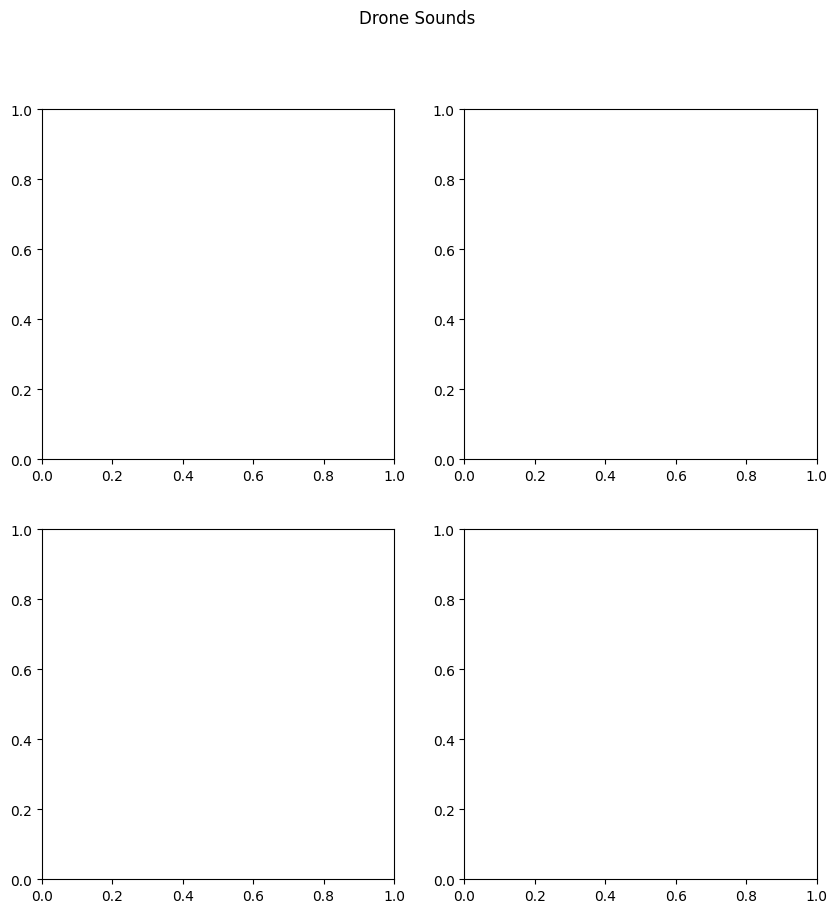

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

label = 'drone' # label for audio clips with bird sounds
data = df[df['label'] == label]

clips = 4 # set the number of clips to display
fig, ax = plt.subplots(int(clips//2), 2, figsize=(10, 10))
plt.suptitle('Drone Sounds')
ax = ax.ravel()

for i in range((clips//2)*2):
    path = data.sample(1).loc[:, 'path'].to_numpy()[0]
    y, sr = librosa.load(path)
    ax[i].set_title('Clip {}'.format(i+1))
    librosa.display.waveplot(y, sr=sr, ax=ax[i], alpha=0.8)
    ax[i].axes.xaxis.set_visible(False)
    ax[i].axes.yaxis.set_visible(False)


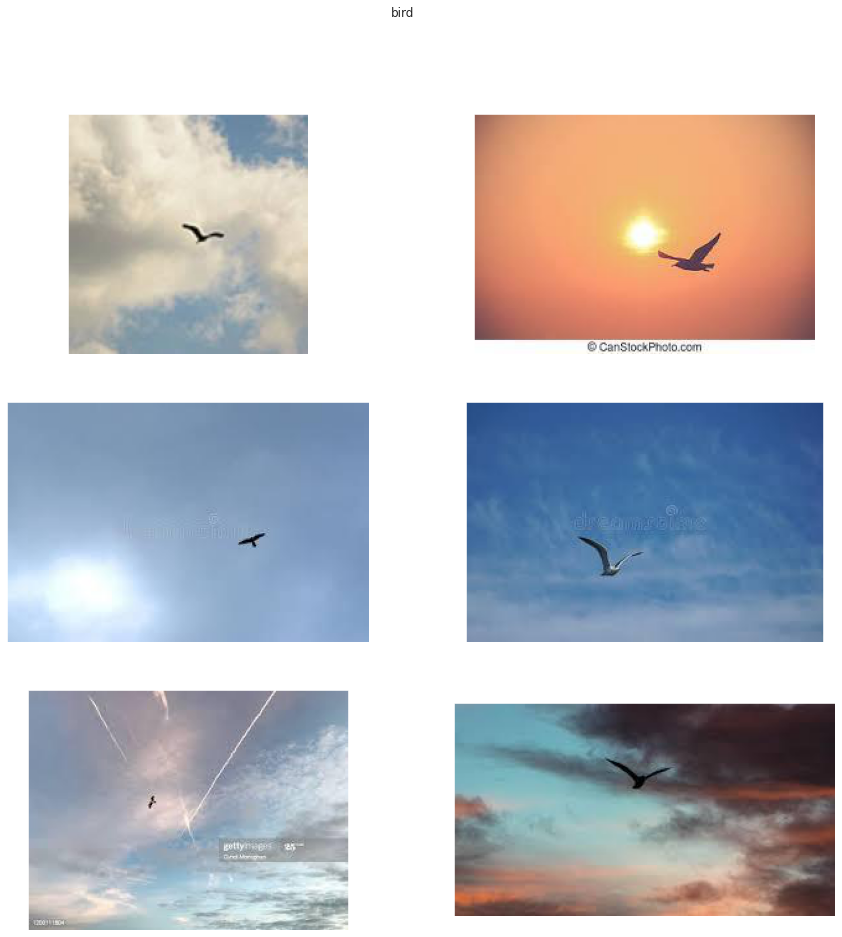

In [ ]:
import keras
import tensorflow as tf

label = 'bird' #label for images with fire
data = df[df['label'] == label]
sns.set_style('dark')


pics = 6 #set the number of pics
fig,ax = plt.subplots(int(pics//2),2,figsize=(15,15))
plt.suptitle('bird')
ax = ax.ravel()
for i in range((pics//2)*2):
    path = data.sample(1).loc[:,'path'].to_numpy()[0]
    img = keras.utils.load_img(path)
    img = image.img_to_array(img)/255
    ax[i].imshow(img)
    ax[i].axes.xaxis.set_visible(False)
    ax[i].axes.yaxis.set_visible(False)

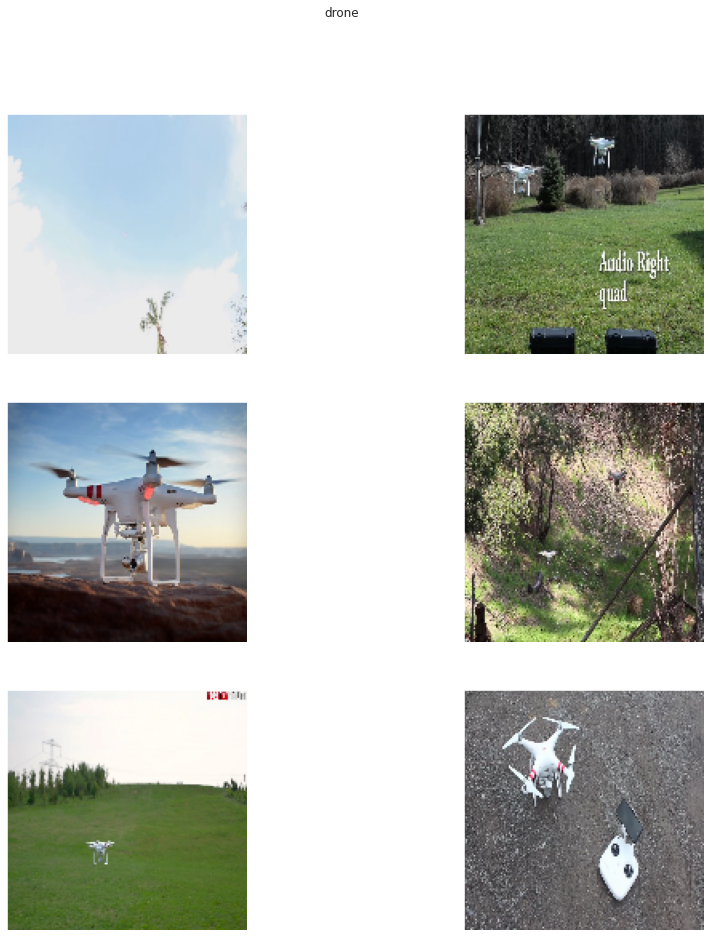

In [ ]:
label = 'drone' #label for images with fire
data = df[df['label'] == label]
sns.set_style('dark')


pics = 6 #set the number of pics
fig,ax = plt.subplots(int(pics//2),2,figsize=(15,15))
plt.suptitle('drone')
ax = ax.ravel()
for i in range((pics//2)*2):
    path = data.sample(1).loc[:,'path'].to_numpy()[0]
    img = tf.keras.utils.load_img(path, target_size=(150,150))
    img = image.img_to_array(img)/255
    ax[i].imshow(img)
    ax[i].axes.xaxis.set_visible(False)
    ax[i].axes.yaxis.set_visible(False)